<a href="https://colab.research.google.com/github/moey920/CashCow_FieldPractice/blob/haram/Detectron2__haram(0325).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 노하람 인턴 테스트용 노트입니다. 혹시 이 노트가 공유되고 있다면 잔디로 알려주시면 감사하겠습니다.

# 2. Detectron2 설치하기

# 새 섹션

In [1]:
# 종속 패키지(dependencies) 설치, 설치후에 Restart Runtime이 나오면 클릭해줍니다.
!pip install -U torch torchvision cython
!pip install -U 'git+https://github.com/facebookresearch/fvcore.git' 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.4.0)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.5.0)
     |████████████████████████████████| 2.1MB 18.8MB/s 
  Found existing installation: Cython 0.29.15
    Uninstalling Cython-0.29.15:
      Successfully uninstalled Cython-0.29.15
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-1tmhi7x1
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-1tmhi7x1
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-8qgnp3p0
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-8qgnp3p0
     |████████████████████████████████| 276kB 49.9MB/s 
  Created wheel for fvcore: filename=fvcore-0.1-cp36-none-any.whl size=42829 sha256=88c45eaa28beefd89301c2f55b7ac56c4d1981f0e88feb2637f994e726ff20f6
  Stored in directory: /tmp/pip-ephem-wheel-cache-ps

'1.4.0'

In [2]:
# Detectiorn2 repo 클론, 인스톨
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 6, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 3506 (delta 0), reused 1 (delta 0), pack-reused 3500
Receiving objects: 100% (3506/3506), 2.14 MiB | 31.33 MiB/s, done.
Resolving deltas: 100% (2418/2418), done.
Obtaining file:///content/detectron2_repo
  Running setup.py develop for detectron2


In [0]:
# 인스톨이 완료되면 Colab Runtime을 다시 시작해주세요. 

# 기본 설정
# detectron2 logger 설정
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# 자주 사용하는 라이브러리 임폴트
import numpy as np
import cv2
import random
import os
from google.colab.patches import cv2_imshow

# 자주 사용하는 detectron2 유틸 임폴트 
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

# 1. Google Drive Api

In [0]:
# Google Drive api 활용, PyDrive package 인스톨
!pip install -U -q PyDrive

In [0]:
# Auth 승인을 받습니다. 코드 실행 시 링크가 나오면 들어가서 계정을 인증하고 인증 코드를 복사해 붙여넣습니다.
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
   
# PyDrive Authentication
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [0]:
# Folder Id로 FileList 받아오기
# 폴더 ID는 개인 드라이브에서 폴더에 들어가면 https://drive.google.com/drive/folders/ 이후에 나오는 주소입니다.

folder_id = '1R4bFN-68jn0Ug-gX4nWYTV0C87x6QN_2'
   
def ListFolder(parent):
    filelist=[]
    file_list = drive.ListFile({'q': "'%s' in parents and trashed=false" % parent}).GetList()
    for f in file_list:
        if f['mimeType']=='application/vnd.google-apps.folder': # if folder
            filelist.append({"id":f['id'],"title":f['title'],"list":ListFolder(f['id'])})
        else:
            filelist.append({"title":f['title'],"id":f['id']})
    return filelist
   
   
file_lists = ListFolder(folder_id)

In [0]:
# Local (colaboratory) directory 지정
# choose a local (colab) directory to store the data.
import os

local_download_path = os.path.expanduser('')
try:
	os.makedirs(local_download_path)
except: pass

In [6]:
# Filename 저장, 여기까지 하면 구글 드라이브 폴더 내의 파일을 Colab에 지정한 장소에 업로드 됩니다.
ret = []
for file in file_lists:
    print('title: %s, id: %s' % (file['title'], file['id']))
    fname = os.path.join(local_download_path, file['title'])
    print('downloading to {}'.format(fname))
    f_ = drive.CreateFile({'id': file['id']})
    f_.GetContentFile(fname)
    print(fname)
    ret.append(fname)

title: coco_instances_results.json, id: 1hNuvq2Iy0DvpB63z9u6jBmJEDo2A74lS
downloading to coco_instances_results.json
coco_instances_results.json
title: coco_instances_results.json, id: 1J_C3btlceeRrdg5lE5ESy5CXW4F2OU-n
downloading to coco_instances_results.json
coco_instances_results.json
title: coco_instances_results.json, id: 1nIm14_ePpSgqytmjLrm3ZT1N7kF_apSM
downloading to coco_instances_results.json
coco_instances_results.json
title: model_final.pth, id: 19cKH3vgRNTCJz6_NSoH6QtL7vvVj435q
downloading to model_final.pth
model_final.pth
title: metrics.json, id: 1T-CS9qshdtkgAObM7YuCEef6RDNgabjt
downloading to metrics.json
metrics.json
title: last_checkpoint, id: 1owxW7Z2NlyB-AlKnKs1ec3kg3Ys9Q562
downloading to last_checkpoint
last_checkpoint
title: instances_predictions.pth, id: 1somrG8VDFM-lFRfjlTcqOo4xciX48Bzq
downloading to instances_predictions.pth
instances_predictions.pth
title: dataset.zip, id: 1zJScCWxOHfk0vRLnLGM6xRpTQiUKyGWw
downloading to dataset.zip
dataset.zip


In [7]:
#import os
#os.chdir('receipt')
!ls

adc.json		     detectron2_repo		metrics.json
coco_instances_results.json  instances_predictions.pth	model_final.pth
dataset.zip		     last_checkpoint		sample_data


In [0]:
# 업로드한 파일을 압축해제합니다.
!unzip dataset.zip > /dev/null

In [9]:
#os.chdir('../')
!ls

adc.json		     detectron2_repo		metrics.json	 train
coco_instances_results.json  instances_predictions.pth	model_final.pth  val
dataset.zip		     last_checkpoint		sample_data


# 커스텀 데이터셋 학습하기

In [0]:
# 인스톨이 완료되면 Colab Runtime을 다시 시작해주세요. 

# 기본 설정
# detectron2 logger 설정
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# 자주 사용하는 라이브러리 임폴트
import numpy as np
import cv2
import random
import os
from google.colab.patches import cv2_imshow
import matplotlib
import json

# 자주 사용하는 detectron2 유틸 임폴트 
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

In [0]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode
import itertools
import cv2

def get_receipt_dicts(img_path,json_path):
    '''
    AD Oct 2019 : loading function to calculate the bboxes from the masks (as it does not exist so far in Detectron2)
    expected format:
    
    {'file_name': 'path/to/image',
    'height' : imgheight,
    'width': imgwidth,
    'annotations':
    [{'bbox': [xmin,ymin,xmax,ymax], 'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'segmentation': [[polygon/coordinates/x/y]],
    'category_id': 0, 'iscrowd': 0}, 
    {'bbox': [xmin2,ymin2,xmax2,ymax2], 'bbox_mode': <BoxMode.XYXY_ABS: 0>,
    'segmentation': [[polygon2/coordinates/x/y]],
    'category_id': 0, 'iscrowd': 0},
    
    etc ...]
    
    }
    INPUTS:
        img_path . str, path to the images
        json_path. str, path to the json annotation file (coco format)
    
    '''
    
    with open(json_path) as f:
        imgs_anns = json.load(f)
    dataset_dicts = []
    
    for img in imgs_anns['images']:
        record = {}
        
        filename = os.path.join(img_path,img['file_name'])
        height, width = cv2.imread(filename).shape[:2]
        image_id = img['id']

        record["file_name"] = filename
        record["height"] = height
        record["width"] = width
        
        for annos in imgs_anns['annotations']:
            if annos['image_id'] == image_id:

                objs = []
                poly = annos['segmentation']
                 
                for p in poly:
                    bbox=[]
                    x, y = p[::2] , p[1::2]
                    bbox.append(np.min(x))
                    bbox.append(np.min(y))
                    bbox.append(np.max(x))
                    bbox.append(np.max(y))
                    obj = {"bbox": bbox,
                            "bbox_mode": BoxMode.XYXY_ABS,
                            "segmentation": [p],
                            "category_id": 0,
                            "iscrowd": 0}
                    objs.append(obj)

        
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances

register_coco_instances("train", {}, "train/receipt_coco.json",
                        "train/")

register_coco_instances("val", {}, "val/receipt_coco.json",
                        "val/")

receipt_metadata_train = MetadataCatalog.get("train")
receipt_metadata_val = MetadataCatalog.get("val")

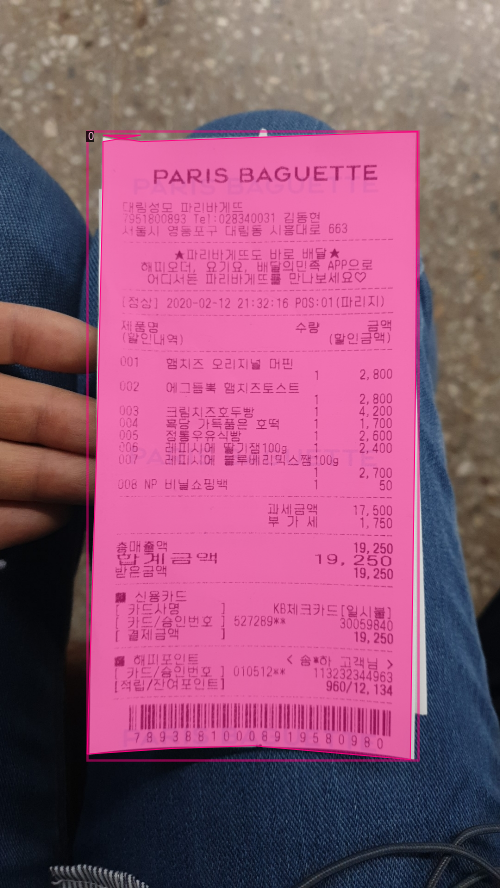

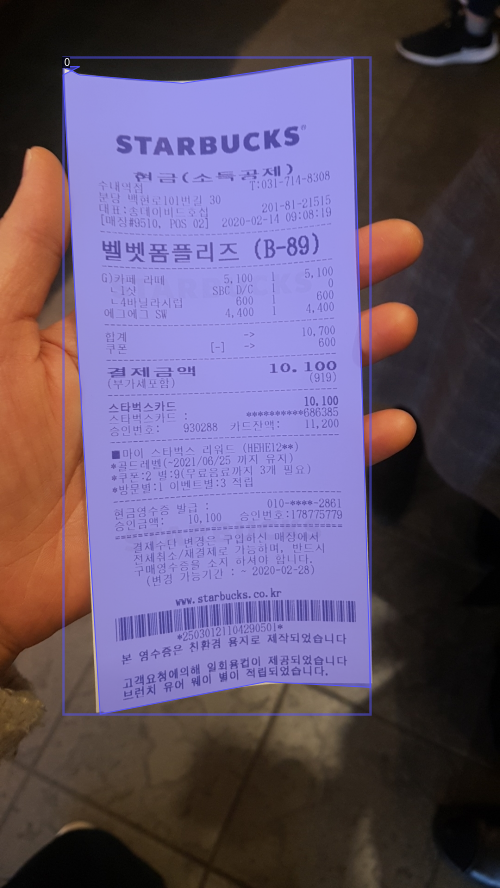

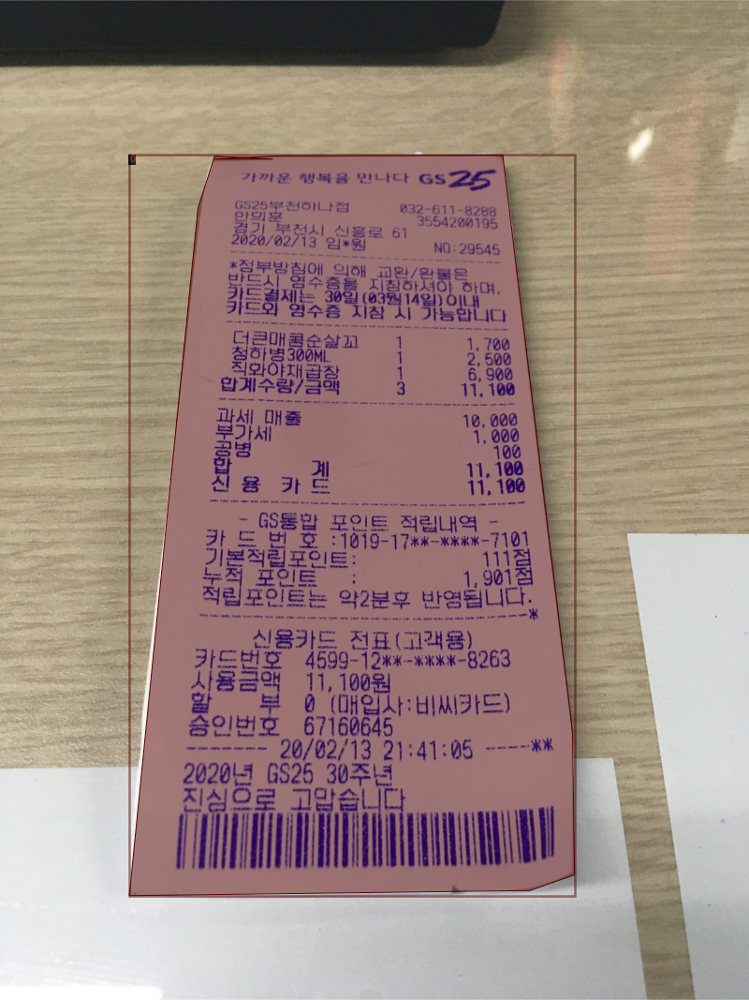

In [12]:
dataset_dicts = get_receipt_dicts("train","train/receipt_coco.json")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], receipt_metadata_train, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Object Detection

In [13]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-Detection/retinanet_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"   # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 900
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 클래스는 "영수증" 클래스 하나 뿐입니다.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

Loading config ./detectron2_repo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


[03/25 05:57:14 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2)

model_final_f10217.pkl: 178MB [00:08, 21.3MB/s]                           


[03/25 05:57:28 d2.engine.train_loop]: Starting training from iteration 0
[03/25 05:57:43 d2.utils.events]:  eta: 0:10:27  iter: 19  total_loss: 1.446  loss_cls: 1.102  loss_box_reg: 0.336  time: 0.7079  data_time: 0.0323  lr: 0.000005  max_mem: 3791M
[03/25 05:57:57 d2.utils.events]:  eta: 0:10:18  iter: 39  total_loss: 2.027  loss_cls: 1.573  loss_box_reg: 0.442  time: 0.7122  data_time: 0.0048  lr: 0.000010  max_mem: 3791M
[03/25 05:58:12 d2.utils.events]:  eta: 0:10:09  iter: 59  total_loss: 2.073  loss_cls: 1.597  loss_box_reg: 0.461  time: 0.7179  data_time: 0.0049  lr: 0.000015  max_mem: 3791M
[03/25 05:58:27 d2.utils.events]:  eta: 0:10:09  iter: 79  total_loss: 2.214  loss_cls: 1.704  loss_box_reg: 0.494  time: 0.7275  data_time: 0.0049  lr: 0.000020  max_mem: 3791M
[03/25 05:58:42 d2.utils.events]:  eta: 0:09:54  iter: 99  total_loss: 2.069  loss_cls: 1.573  loss_box_reg: 0.484  time: 0.7275  data_time: 0.0046  lr: 0.000025  max_mem: 3791M
[03/25 05:58:56 d2.utils.events]:  e

In [14]:
# tensorboard를 사용해서 학습 커브를 살펴봅니다.
%load_ext tensorboard
%tensorboard --logdir output

In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("val", )
predictor = DefaultPredictor(cfg)

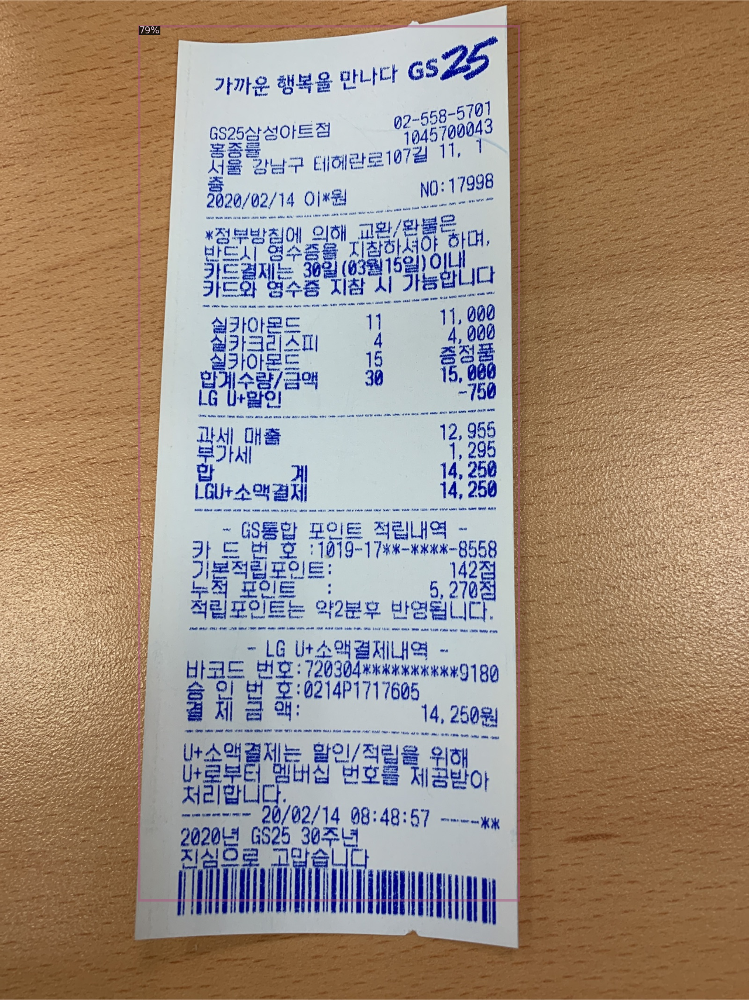

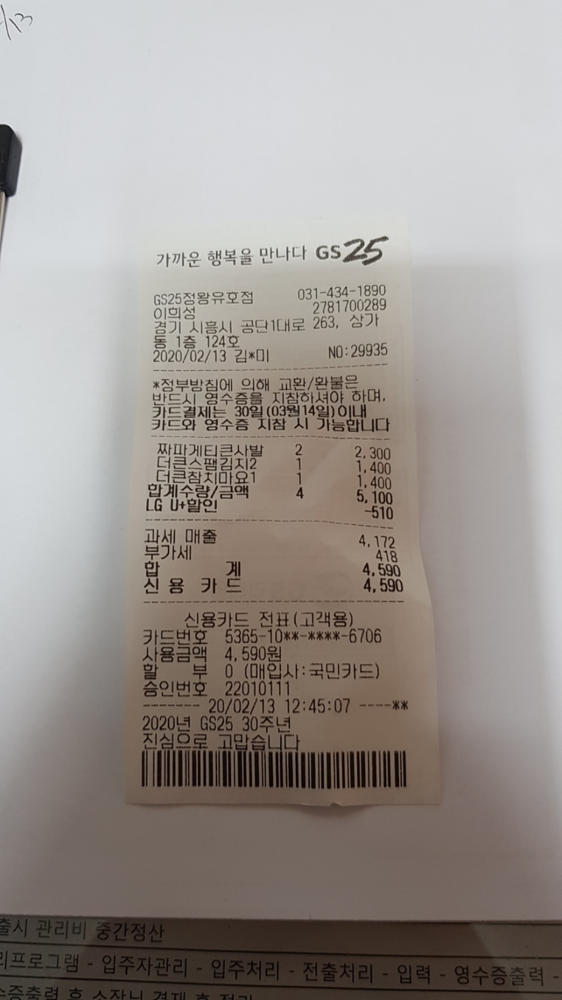

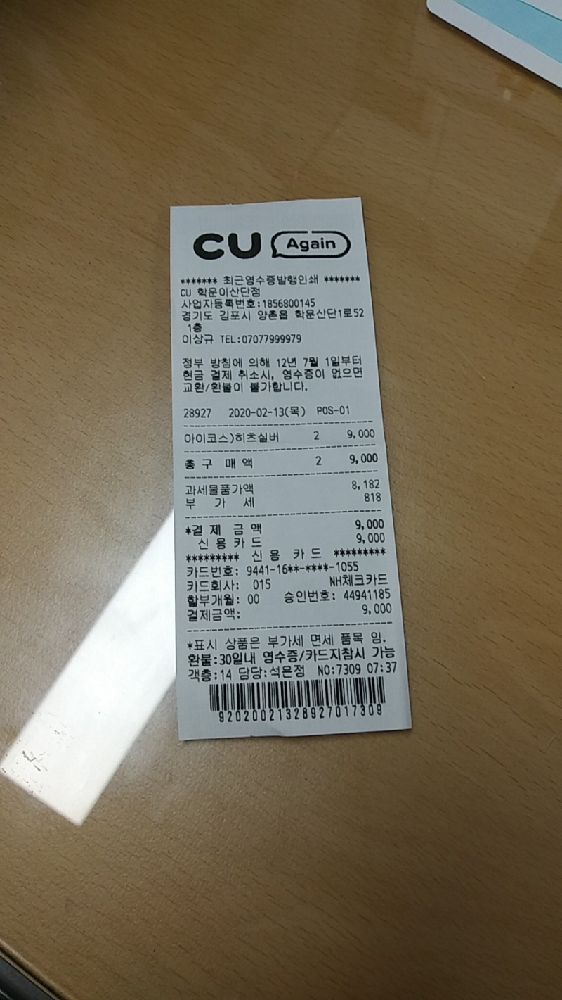

In [16]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_receipt_dicts("val","val/receipt_coco.json")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=receipt_metadata_train, 
                   scale=0.8
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [17]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[03/25 06:08:43 d2.data.datasets.coco]: Loaded 100 images in COCO format from val/receipt_coco.json
[03/25 06:08:43 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|  receipt   | 100          |
|            |              |
[03/25 06:08:43 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[03/25 06:08:43 d2.data.common]: Serialized dataset takes 0.05 MiB
[03/25 06:08:43 d2.evaluation.evaluator]: Start inference on 100 images
[03/25 06:08:46 d2.evaluation.evaluator]: Inference done 11/100. 0.2361 s / img. ETA=0:00:21
[03/25 06:08:51 d2.evaluation.evaluator]: Inference done 33/100. 0.2276 s / img. ETA=0:00:15
[03/25 06:08:56 d2.evaluation.evaluator]: Inference done 55/100. 0.2270 s / img. ETA=0:00:10
[03/25 06:09:01 d2.evaluation.evaluator]: Inference done 77/100. 0.2290 s / img. ETA=0:00:05
[03/25 06:09:06 d2.evaluation.evaluator]: Inference done 99/100. 0.2286 s / img. E

OrderedDict([('bbox',
              {'AP': 65.44489451342862,
               'AP50': 99.91177335555336,
               'AP75': 86.43305180304372,
               'APl': 65.44489451342862,
               'APm': nan,
               'APs': nan})])

# Instance Segmentation

이제 학습을 진행할 단계입니다. COCO 데이터셋으로 학습된 R50-FPN Mask R-CNN 모델을 불러와서 영수증 데이터셋으로 fine-tune해 봅시다. Colab의 K80 GPU를 기준으로, 300 iterations 학습시키는데 대략 6분정도의 시간이 소요됩니다(P100 GPU의 경우 2분 가량 소요됩니다).

In [18]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 900    # 300 iterations 정도면 충분합니다. 더 오랜 시간도 시도해보세요.
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 1024   # 영수증 데이터셋과 같이 적당한 데이터셋에서는 이정도면 적당합니다, 작은 데이터셋은 124로 하면 됩니다.
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 클래스는 "영수증" 클래스 하나 뿐입니다.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[03/25 06:09:07 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (2, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (2,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (4, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (4,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (1,) in the model! Skipped.


[03/25 06:09:07 d2.engine.train_loop]: Starting training from iteration 0
[03/25 06:09:24 d2.utils.events]:  eta: 0:12:15  iter: 19  total_loss: 1.613  loss_cls: 0.856  loss_box_reg: 0.037  loss_mask: 0.694  loss_rpn_cls: 0.000  loss_rpn_loc: 0.008  time: 0.8332  data_time: 0.0201  lr: 0.000005  max_mem: 3791M
[03/25 06:09:41 d2.utils.events]:  eta: 0:11:52  iter: 39  total_loss: 1.359  loss_cls: 0.641  loss_box_reg: 0.036  loss_mask: 0.653  loss_rpn_cls: 0.002  loss_rpn_loc: 0.010  time: 0.8246  data_time: 0.0044  lr: 0.000010  max_mem: 3791M
[03/25 06:09:57 d2.utils.events]:  eta: 0:11:35  iter: 59  total_loss: 1.029  loss_cls: 0.387  loss_box_reg: 0.040  loss_mask: 0.579  loss_rpn_cls: 0.001  loss_rpn_loc: 0.008  time: 0.8210  data_time: 0.0053  lr: 0.000015  max_mem: 3791M
[03/25 06:10:13 d2.utils.events]:  eta: 0:11:12  iter: 79  total_loss: 0.768  loss_cls: 0.210  loss_box_reg: 0.038  loss_mask: 0.497  loss_rpn_cls: 0.001  loss_rpn_loc: 0.010  time: 0.8135  data_time: 0.0050  lr:

In [19]:
# tensorboard를 사용해서 학습 커브를 살펴봅니다.
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 822), started 0:13:11 ago. (Use '!kill 822' to kill it.)

# 학습한 모델 실행 및 평가하기

영수증 데이터셋의 검증(validation) 데이터셋으로 테스트를 해볼 차례입니다.

우선, 방금 전 학습한 모델을 불러와서 predictor를 생성합니다.

In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("val", )
predictor = DefaultPredictor(cfg)

샘플을 몇 개 뽑아 살펴봅니다.

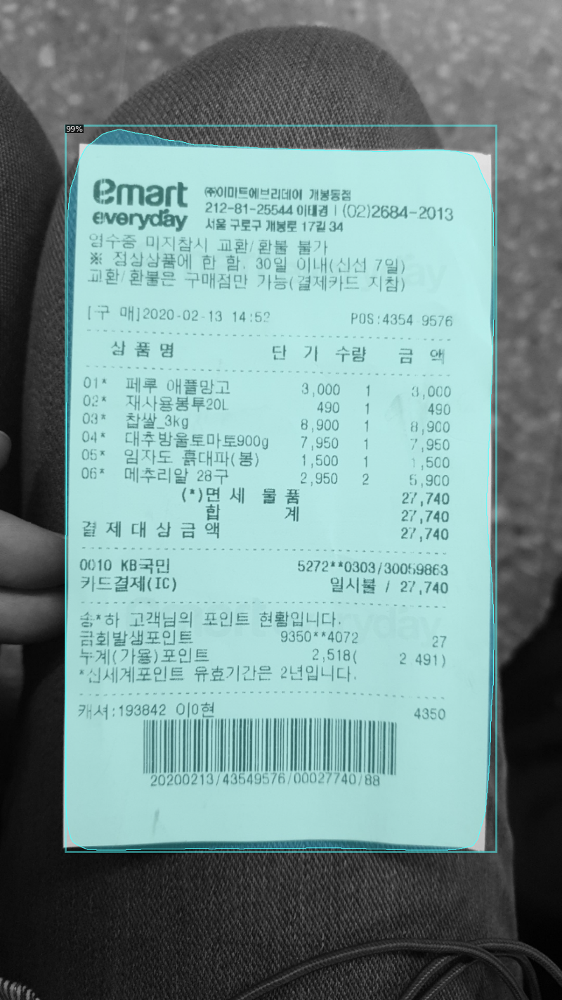

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


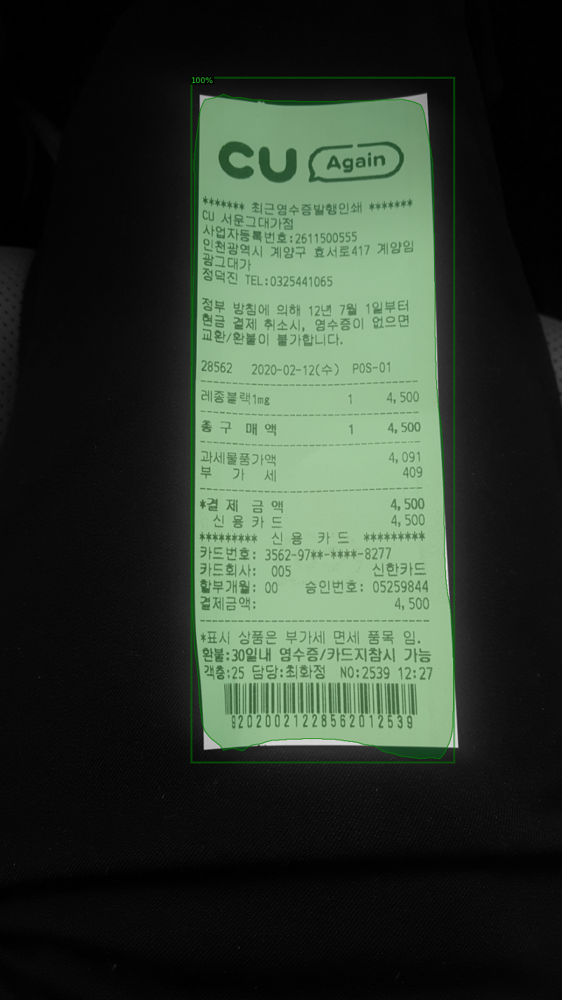

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


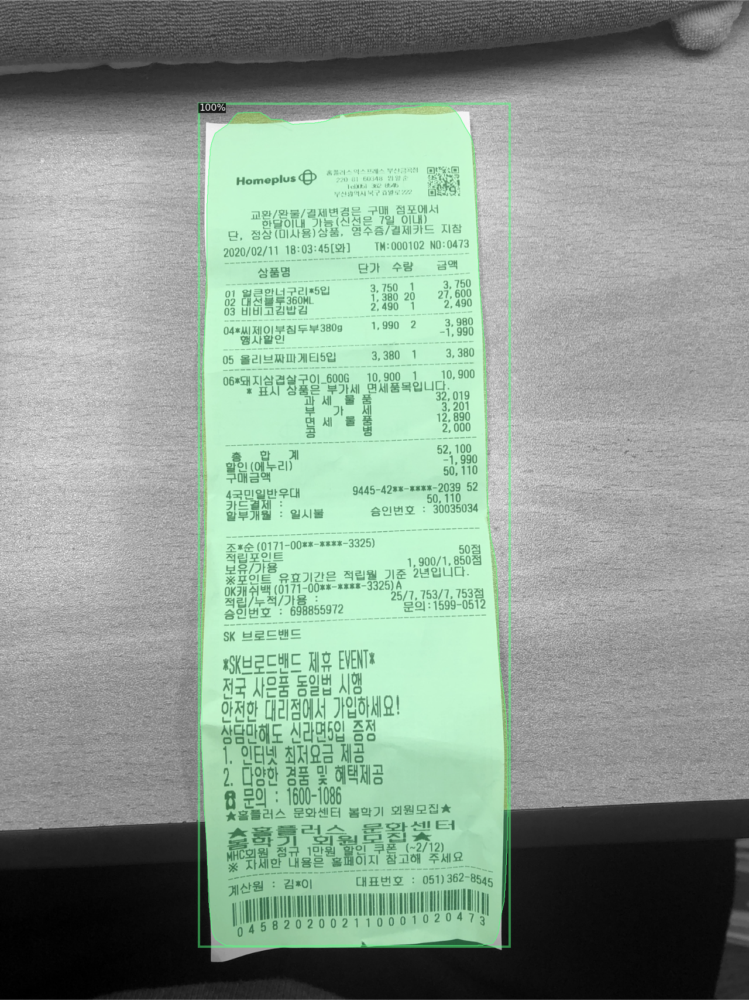

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


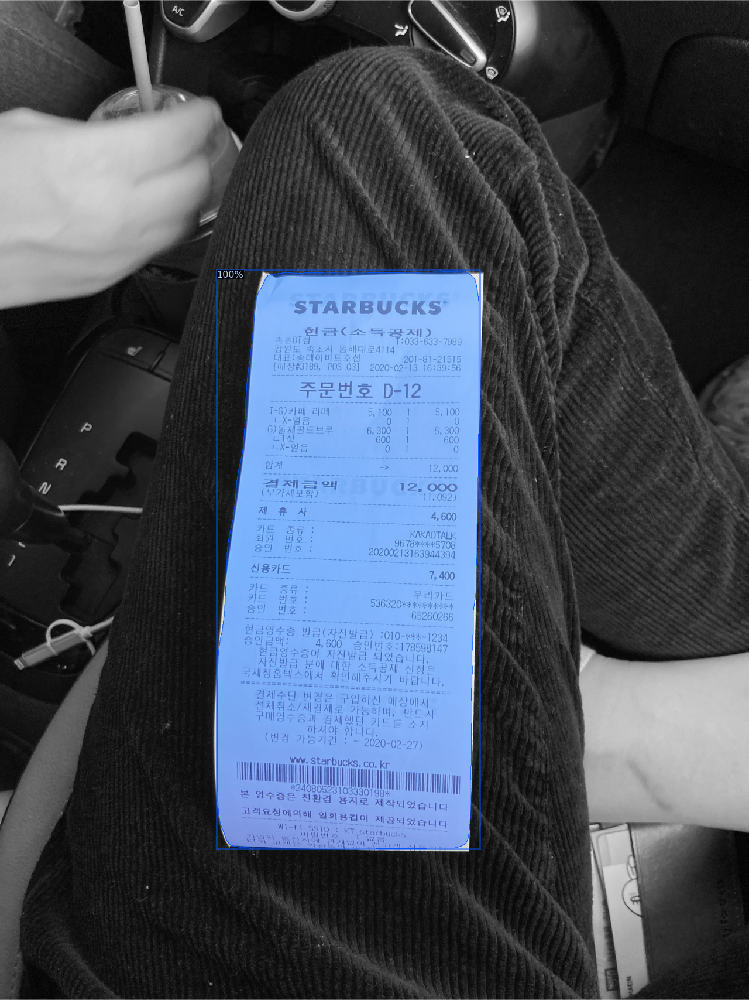

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


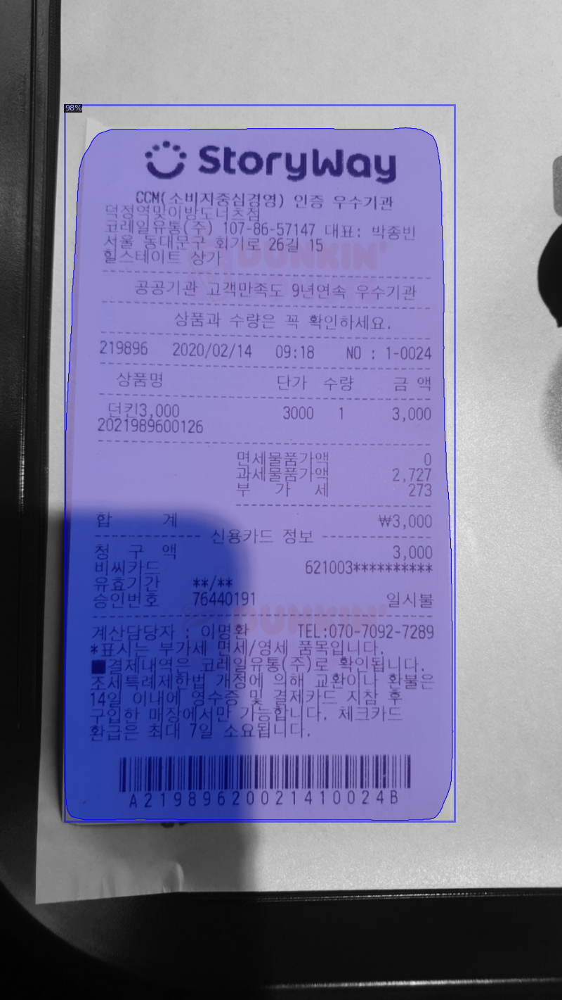

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [21]:
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import GenericMask
from detectron2.utils.visualizer import VisImage
from detectron2.structures import BitMasks, Boxes, BoxMode, Keypoints, PolygonMasks, RotatedBoxes
dataset_dicts = get_receipt_dicts("val","val/receipt_coco.json")
for d in random.sample(dataset_dicts, 5):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=receipt_metadata_train, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
                   #instance_mode=ColorMode.SEGMENTATION
                   #instance_mode = GenericMask.mask_to_polygons

    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])
    VisImage.save(v, "./output/")

In [22]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "val")
inference_on_dataset(trainer.model, val_loader, evaluator)
# another equivalent way is to use trainer.test

[03/25 06:21:57 d2.data.datasets.coco]: Loaded 100 images in COCO format from val/receipt_coco.json
[03/25 06:21:57 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[03/25 06:21:57 d2.data.common]: Serialized dataset takes 0.05 MiB
[03/25 06:21:57 d2.evaluation.evaluator]: Start inference on 100 images
[03/25 06:22:00 d2.evaluation.evaluator]: Inference done 11/100. 0.1704 s / img. ETA=0:00:16
[03/25 06:22:05 d2.evaluation.evaluator]: Inference done 38/100. 0.1691 s / img. ETA=0:00:11
[03/25 06:22:10 d2.evaluation.evaluator]: Inference done 66/100. 0.1669 s / img. ETA=0:00:06
[03/25 06:22:15 d2.evaluation.evaluator]: Inference done 93/100. 0.1667 s / img. ETA=0:00:01
[03/25 06:22:16 d2.evaluation.evaluator]: Total inference time: 0:00:17.606639 (0.185333 s / img per device, on 1 devices)
[03/25 06:22:16 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:15 (0.166102 s / img per device, on 1 devices)
[03/25 06:22:16 d2.evaluation.co

OrderedDict([('bbox',
              {'AP': 91.96028247297305,
               'AP50': 100.0,
               'AP75': 100.0,
               'APl': 91.96028247297305,
               'APm': nan,
               'APs': nan}),
             ('segm',
              {'AP': 99.23517867250644,
               'AP50': 100.0,
               'AP75': 100.0,
               'APl': 99.23517867250644,
               'APm': nan,
               'APs': nan})])

In [23]:
!ls output

coco_instances_results.json			   last_checkpoint
events.out.tfevents.1585115839.0b551e24e850.530.0  metrics.json
events.out.tfevents.1585116547.0b551e24e850.530.1  model_final.pth
instances_predictions.pth


# 구글 드라이브에 모델 저장하기

In [0]:
# 1. Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# 2. Create & upload a file text file.
# 특정 폴더 안으로 파일 삽입
uploaded = drive.CreateFile({'title': 'coco_instances_results.json', "parents": [{"kind": "drive#fileLink","id": '1R4bFN-68jn0Ug-gX4nWYTV0C87x6QN_2'}]})
uploaded.SetContentString('Sample upload file content')
uploaded.SetContentFile('output/coco_instances_results.json')
uploaded.Upload()
print('Uploaded file with ID {}'.format(uploaded.get('id')))
# 3. Load a file by ID and print its contents.
downloaded = drive.CreateFile({'id': uploaded.get('id')})

Uploaded file with ID 1hNuvq2Iy0DvpB63z9u6jBmJEDo2A74lS


In [0]:
for key in outputs.keys():
    print(key, ":", outputs[key])
    print(outputs['instances'].pred_masks)

instances : Instances(num_instances=1, image_height=1777, image_width=1000, fields=[pred_boxes: Boxes(tensor([[ 243.5001,   75.5808,  753.4091, 1467.8177]], device='cuda:0')), scores: tensor([0.9992], device='cuda:0'), pred_classes: tensor([0], device='cuda:0'), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]], device='cuda:0')])
tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, Fal

In [0]:
with open('output/coco_instances_results.json') as f :
    json_data = json.load(f)
json_data

[{'bbox': [262.7149658203125,
   27.3489990234375,
   995.9212646484375,
   2043.9844970703125],
  'category_id': 1,
  'image_id': 1,
  'score': 0.9985581040382385,
  'segmentation': {'counts': 'g]Ua0d8Sg0RMl3i7\\HQKf4T7SJSKT3[6ULSKU2j5VMnJk1m5bMiJa1P6nMdJW1S6YN`Jo0Q6eNhJ=i5XOZK@U57jKdNd4S1lKYNb4^1jKRNb4f1jKjMb4o1hKcMc4V2gK\\Mc4_2eKoLk4k2]KcLR5Y3VKSLZ5h3oJdKb5V4gJUKk5e4mKPIl4j6iLeFZ4U9ij0I8H8I8G9H8G:F:G:E;F9F7J6I6K5J6K5K4K5L4L4K5L3M4K4M3M3L4M3M3N2N1O2N2N2N2N2N2N2N2N1O2N1O2N1N2O1O2N1O1O1O1O1O1O1O001O1O1O1O001O1N101O0000000O1000001N1000000O1000000O1000000O1000001N1000000O10000O10000000000001O00001O00001O00001O00001O00001O00001O0000001O00001O00000O2O0000001O000000000000001O000000000000001O00000000000000001O00000000000000001O00000000O10000000000000000000000000000000000O10000000000000000000000000000000000O100000000000000000000000000000000O10O1000000000000000000000000000000000001O00000000001O000001O0001O0000000000001O0000000000001O00000000000000000000000000000000000000O1000000000000000000000

# BBOX CROP

In [0]:
output_bboxes = []
for d in dataset_dicts:    
    im = cv2.imread(d["file_name"])
    output = predictor(im)
    #print(output["instances"].scores)
    pts = output["instances"].pred_boxes.tensor[0].tolist()
    output_bboxes.append(pts)
print(output_bboxes)

[[253.24404907226562, 37.1287841796875, 1242.0389404296875, 2084.13134765625], [273.69183349609375, 72.3619155883789, 761.462890625, 1519.093505859375], [167.61056518554688, 232.46290588378906, 777.74267578125, 1483.1680908203125], [253.78805541992188, 413.23602294921875, 1129.773681640625, 1842.740234375], [158.20440673828125, 267.5736389160156, 753.8732299804688, 1262.988037109375], [130.7860565185547, 238.57093811035156, 816.7930908203125, 1286.3941650390625], [413.0953369140625, 124.34527587890625, 1192.4736328125, 1958.740234375], [136.961669921875, 112.72096252441406, 906.201416015625, 1460.3887939453125], [199.46237182617188, 231.0203399658203, 945.5252685546875, 1443.7655029296875], [218.85836791992188, 119.76732635498047, 769.2362060546875, 1495.8717041015625], [95.52214050292969, 137.23512268066406, 781.4357299804688, 1497.1832275390625], [173.87185668945312, 70.55602264404297, 840.61474609375, 1432.4530029296875], [308.7412109375, 214.09710693359375, 1201.4927978515625, 1977

In [0]:
output_bboxes[1]

In [0]:
for number in range(len(output_bboxes)):
    pts = output_bboxes[number]
    a = pts[0], pts[1], pts[2], pts[3]

In [26]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [27]:
import os
import random
for d in dataset_dicts:    
    im = cv2.imread(d["file_name"])
    output = predictor(im)
    pts = output["instances"].pred_boxes.tensor[0].tolist()
    crop_img = im[int(pts[1])-1:int(pts[3])+1, int(pts[0])-1:int(pts[2])+1] 
    #print(len(pts))
    #print(len(crop_img))
    cv2.imwrite('/content/drive/My Drive/img/crop'+ str(random.randrange(1,101)) + '.jpg',crop_img)
    #cv2.imwrite('/content/drive/My Drive/img/crop'+ str(d["file_name"]) + '.jpg',crop_img)

4
2015
4
1432
4
1230
4
1401
4
1010
4
1082
4
1833
4
1332
4
1211
4
1333
4
1352
4
1382
4
1834
4
1768
4
928
4
996
4
1601
4
1986
4
1218
4
1216
4
1980
4
1726
4
932
4
1303
4
1639
4
961
4
757
4
1354
4
1767
4
1229
4
1255
4
1407
4
1236
4
1163
4
1384
4
1458
4
1287
4
1567
4
1428
4
1697
4
1581
4
1316
4
1252
4
1372
4
1243
4
1709
4
1573
4
1644
4
1079
4
1434
4
1222
4
1542
4
1521
4
1349
4
1773
4
1331
4
948
4
1072
4
1180
4
1090
4
1214
4
1417
4
1658
4
1215
4
1114
4
1308
4
1380
4
1563
4
1387
4
1274
4
1467
4
1747
4
1178
4
1186
4
945
4
1331
4
1265
4
1677
4
1796
4
1024
4
1231
4
1831
4
1291
4
1394
4
1800
4
1448
4
1864
4
1229
4
1448
4
1833
4
1414
4
1843
4
1118
4
1076
4
1209
4
1590
4
1322
4
1630
4
1176
4
1336


Instances(num_instances=1, image_height=2134, image_width=1600, fields=[pred_boxes: Boxes(tensor([[ 282.9026,  173.4514, 1274.3745, 1871.7527]], device='cuda:0')), scores: tensor([0.9957], device='cuda:0'), pred_classes: tensor([0], device='cuda:0'), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]], device='cuda:0')])
tensor([ 282.9026,  173.4514, 1274.3745, 1871.7527], device='cuda:0')
Boxes(tensor([[ 282.9026,  173.4514, 1274.3745, 1871.7527]], device='cuda:0'))
<class 'list'>
[282.902587890625, 173.451416015625, 1274.37451171875, 1871.752685546875]
282.902587890625 173.451416015625 1274.37451171875 1871.752685546875


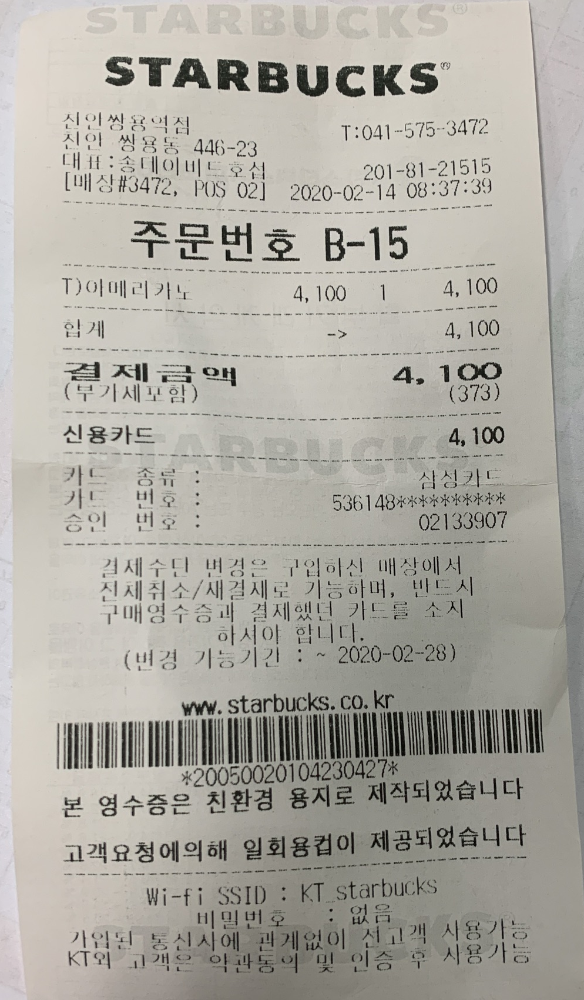

In [0]:
from detectron2.data.detection_utils import *

print(outputs["instances"])

print(outputs["instances"].pred_boxes.tensor[0])

pts = outputs["instances"].pred_boxes.tensor[0].tolist()
print(type(pts))
print(pts)

print(pts[0], pts[1], pts[2], pts[3])

crop_img = im[int(pts[1])-1:int(pts[3])+1, int(pts[0])-1:int(pts[2])+1]

cv2_imshow(crop_img)

In [0]:
data_file = open('/content/drive/My Drive/datt/coco_instances_results.json', "r") 
#json_file = open('output/coco_instances_results.json', "r")

In [0]:
import json
from collections import OrderedDict
 
with open('output/coco_instances_results.json', encoding="utf-8") as data_file:    
    data = json.load(data_file)#, object_pairs_hook=OrderedDict)


for item in data :
  print('id', item['image_id'], 'bbox', item['bbox'])

id 1 bbox [262.7149658203125, 27.3489990234375, 995.9212646484375, 2043.9844970703125]
id 2 bbox [276.38470458984375, 86.75773620605469, 486.36895751953125, 1413.493408203125]
id 3 bbox [173.03836059570312, 255.70033264160156, 607.2998046875, 1198.043212890625]
id 4 bbox [272.8818054199219, 418.54962158203125, 869.88427734375, 1420.872802734375]
id 4 bbox [1028.639404296875, 0.0, 566.786376953125, 263.24285888671875]
id 5 bbox [172.08688354492188, 242.40980529785156, 575.11572265625, 1011.139892578125]
id 6 bbox [136.5887908935547, 138.84646606445312, 690.79296875, 1148.056640625]
id 6 bbox [0.0, 968.5580444335938, 142.69149780273438, 281.44342041015625]
id 7 bbox [412.5248718261719, 118.63629150390625, 783.71435546875, 1833.3203125]
id 8 bbox [153.83517456054688, 91.13353729248047, 731.17333984375, 1369.021240234375]
id 9 bbox [203.6377410888672, 218.19393920898438, 753.7131958007812, 1221.190185546875]
id 10 bbox [220.5953826904297, 128.5963592529297, 551.6393432617188, 1321.02612304

In [0]:
tmp = []
for item in data :

    #print(item['bbox'])
    #print(type(item['bbox']))
    bbox = item['bbox']
    #print(bbox[0], bbox[1], bbox[2], bbox[3])
    #print('id', item['image_id'], 'score :', item['score'],'===', bbox)
    tmp.append([item['image_id'], item['score'], bbox[0], bbox[1], bbox[2], bbox[3]])
print(tmp[:])
print(tmp[3], tmp[4]) # 3번과 4번은 image_id가 같지만 다른 score를 가지고 있다. 스코어가 높은 것이 정확한 bbox를 가지고 있다.

if tmp[:][0] == tmp[1:][0] : # 만약 tmp에서 image_id가 같고
    if tmp[:][1] >= tmp[1:][1] : # 스코어가 더 크다면
        del tmp[:]
print(tmp)

[[1, 0.9985581040382385, 262.7149658203125, 27.3489990234375, 995.9212646484375, 2043.9844970703125], [2, 0.9985370635986328, 276.38470458984375, 86.75773620605469, 486.36895751953125, 1413.493408203125], [3, 0.9947205781936646, 173.03836059570312, 255.70033264160156, 607.2998046875, 1198.043212890625], [4, 0.9966949224472046, 272.8818054199219, 418.54962158203125, 869.88427734375, 1420.872802734375], [4, 0.111396923661232, 1028.639404296875, 0.0, 566.786376953125, 263.24285888671875], [5, 0.9982137680053711, 172.08688354492188, 242.40980529785156, 575.11572265625, 1011.139892578125], [6, 0.9918934106826782, 136.5887908935547, 138.84646606445312, 690.79296875, 1148.056640625], [6, 0.06322471797466278, 0.0, 968.5580444335938, 142.69149780273438, 281.44342041015625], [7, 0.9987244009971619, 412.5248718261719, 118.63629150390625, 783.71435546875, 1833.3203125], [8, 0.9935423135757446, 153.83517456054688, 91.13353729248047, 731.17333984375, 1369.021240234375], [9, 0.9895776510238647, 203.6

In [0]:
    crop_img = im[bbox[1]:bbox[3], bbox[0]:bbox[2]]
    cv2_imshow(crop_img)

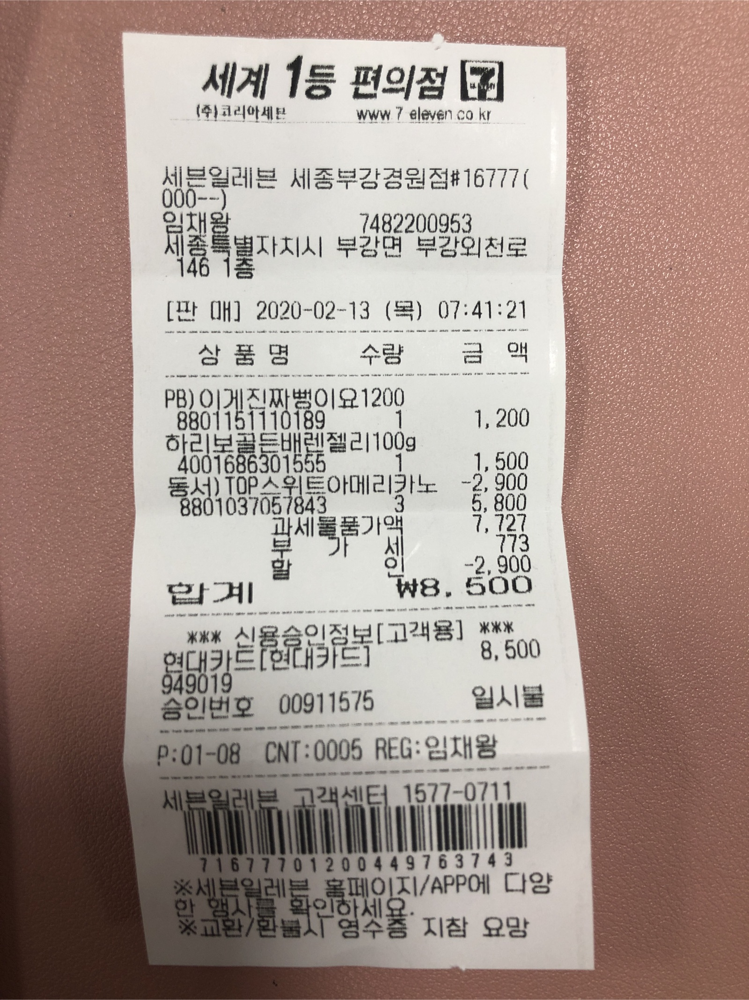

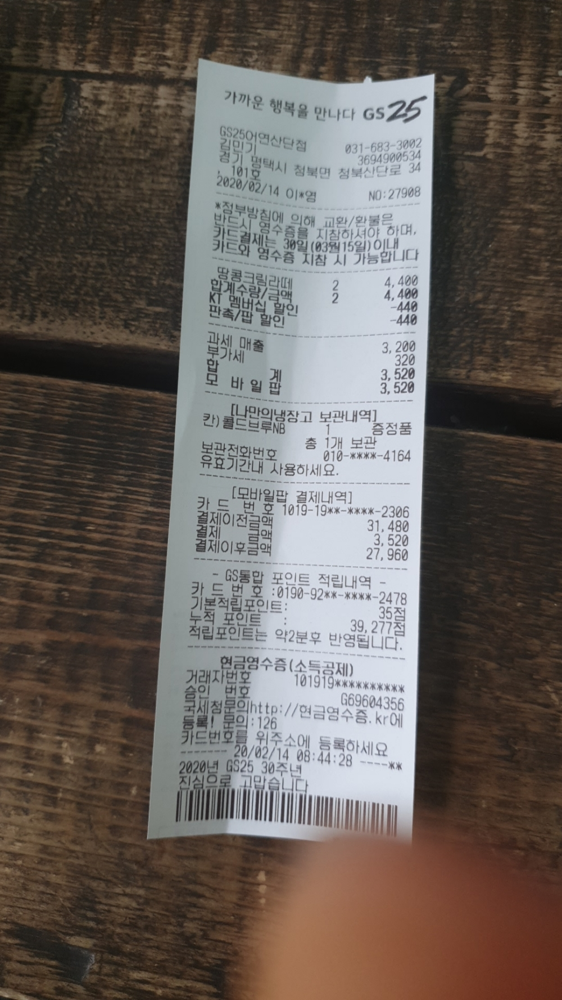

In [0]:
for d in dataset_dicts:    
    im = cv2.imread(d["file_name"])
    cv2_imshow(im)